In [16]:
%matplotlib notebook

import matplotlib
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm

import scipy.ndimage as nd
import ipywidgets as widgets
from ipywidgets import interact

from collections import OrderedDict

from skimage.io import imread, imsave
from glob import glob

import PIL.Image
import io
import IPython.display
from IPython.display import display, HTML, Javascript
import numpy as np
import base64

from matplotlib.backends.backend_agg import FigureCanvasAgg

# https://gist.github.com/kylemcdonald/2f1b9a255993bf9b2629
# Minimal code for rendering a numpy array as an image 
# in a Jupyter notebook in memory.

def showarray(a, width=None):
    buf = io.BytesIO()
    PIL.Image.fromarray(a.astype('uint8')).save(buf, format='png')
    IPython.display.display(IPython.display.Image(data=buf.getvalue(),
                                                  width=width))

def htmlarray(a, width=None):
    buf = io.BytesIO()
    PIL.Image.fromarray(a.astype('uint8')).save(buf, format='png')                                                         
    return ("<img src='data:image/png;base64,"+
            base64.b64encode(buf.getvalue()).decode('ascii')+
            "' style='display: inline;vertical-align:baseline;'/> ")

def matplotlib_to_numpy(fig):
    fig.canvas.draw()
    data = np.fromstring(fig.canvas.tostring_rgb(), dtype=np.uint8, sep='')
    data = data.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    plt.close(fig)
    return data
    
def showarrays(img_list, n_columns=5, width=100, column_titles=None):
    s = "<div style='float: left;'><center>"
    s+= "<table style='width:"+str(width)+"%; border:0px !important; border-collapse:collapse;'>"
    s += "<tr style='border: 0px !important;'>"
    if column_titles is not None:
        n_columns = len(column_titles)
        for i in range(n_columns):
            s += '<td style="border:0px !important;"><center><b>%s</b></center></td>' % column_titles[i]
    s += "</tr><tr style='border: 0px !important;'>"  
    for i in range(len(img_list)):
        buf = io.BytesIO()

        if isinstance(img_list[i], matplotlib.figure.Figure):
            # matplotlib figure
            img_list[i] = matplotlib_to_numpy(img_list[i])

        # numpy array
        PIL.Image.fromarray(img_list[i].astype('uint8')).save(buf, format='png')
        s += '<td style="border: 0px !important;"><img width="%s"' % img_list[i].shape[1]
        s += ' src="data:image/png;base64,' + base64.b64encode(buf.getvalue()).decode('ascii') + '"/></td>'
        if ((i+1) % n_columns) == 0:
            s += "</tr><tr style='border: 0px !important;'>"    
    s += "</table></center></div>"
    IPython.display.display(IPython.display.HTML(s))
    
def random_colormap(n):
    """
    Return a list of random RGB values. Actually the first 10 colors are not random.
    """
    rng = np.random.RandomState(seed=0)
    # http://cloford.com/resources/colours/500col.htm
    default_colors = np.array([[0, 0, 255],  # blue
                               [255, 0, 0],  # red
                               [0, 255, 0],  # green
                               [61, 89, 171],  # cobalt
                               [237, 145, 33],  # carrot
                               [218, 112, 214],  # orchid
                               [255, 182, 193],  # lightpink
                               [143, 188, 143],  # darkseagreen
                               [0, 245, 255],  # turquoise
                               [250, 128, 114],  # salmon
                               [0, 153, 76],  # pastel green
                               [0, 128, 255],  # pastel blue
                               [255, 255, 0],  # yellow
                               [204, 204, 255],  # pastel purple
                               ], dtype='uint8')
    color_dict = {}
    for i in range(0, n):
        if i < default_colors.shape[0]:
            color_dict[i] = default_colors[i]
        else:
            color_dict[i] = rng.random_integers(0, 255, 3)

    for k in color_dict.keys():
        color_dict[k] = np.array(color_dict[k]).astype('float') / 255

    return OrderedDict(sorted(color_dict.items()))

def remap(a, mapping_dict=None, mapping=None):
    """
    Replace the values in an array of integers by new values given by a mapping.

    Parameters
    ----------
    a: input array of integers
    mapping_dict: dictionary of the form `{ old_value : new_value }`
    mapping: list of integer so that i will be mapped to `mapping[i]`

    Returns
    -------
    np.array of the same shape and its values changed according to the mapping.
    """
    if not mapping_dict and not mapping:
        raise ValueError("Either mapping_dict or mapping must be defined")
    if not mapping:
        depth = len(list(mapping_dict.values())[0])
        mapping = np.zeros((np.max(list(mapping_dict.keys())) + 1, depth))
        for i, c in mapping_dict.items():
            mapping[i] = c
    mapping = np.array(mapping)
    depth = mapping.shape[1]
    shape = a.shape
    if depth > 1:
        shape = list(shape) + [depth]
    return mapping[a.flatten()].reshape(shape)


def get_matplotlib_colormap(colormap=plt.cm.jet):
    return dict(list(zip(np.arange(256).astype('int'), colormap(np.arange(256))[:, :3])))


def overlay_segmentation(img, seg, colormap=None, opacity=0.45, color_background=False):
    """
    Parameters
    ----------
    img: Input 2D image
    seg: Input 2D segmentation
    colormap: dictionary of `{label: rgb_color}` with rgb_color in [0.0;1.0]
    opacity: opacity for the overlay
    color_background: whether to colorize the background

    Returns
    -------
    2D RGB image
    """
    # make a color map of fixed colors
    if not colormap:
        n = seg.max() + 1
        colormap = random_colormap(n)
    img = np.concatenate((img[..., np.newaxis],) * 3, axis=2)
    rgb_overlay = remap(seg, colormap) * 255
    if color_background:
        img = (1 - opacity) * img + opacity * rgb_overlay
    else:
        img[seg != 0] = (1 - opacity) * img[seg != 0] + opacity * rgb_overlay[seg != 0]
    return img

def plot_image(img, seg=None, proba=None, alpha=0.45, dpi=20, figsize=None, backend='nbAgg'):
    old_backend = matplotlib.get_backend()
    if backend != old_backend:
        plt.switch_backend(backend)
    if figsize is not None:
        # https://github.com/matplotlib/matplotlib/issues/4853
        matplotlib.rcParams['savefig.dpi'] = dpi
        matplotlib.rcParams['figure.dpi'] = dpi
        fig = plt.figure(figsize=figsize,dpi=dpi)
    else:
        matplotlib.rcParams['savefig.dpi'] = dpi
        matplotlib.rcParams['figure.dpi'] = dpi
        fig = plt.figure(figsize=(img.shape[1]/dpi, img.shape[0]/dpi),
                         dpi=dpi, frameon=False)
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    fig.add_axes(ax)
    plt.gray()
    ax.imshow(img, aspect='auto', interpolation="nearest", zorder=0)
    if seg is not None:
        # discrete colormap for matplotlib
        colormap = random_colormap(np.array(seg).max()+1) # +1 for background 0
        sorted_colors = np.array(list(colormap.values()))
        sorted_bounds = list(sorted(colormap.keys()))
        sorted_bounds += [sorted_bounds[-1] + 1]
        cmap = matplotlib.colors.ListedColormap(sorted_colors)
        norm = matplotlib.colors.BoundaryNorm(sorted_bounds, cmap.N)
        seg = np.ma.masked_where(seg==0, seg)
        ax.imshow(seg, aspect='auto', interpolation="nearest", 
                  cmap=cmap, norm=norm, alpha=alpha)
    if proba is not None:
        proba = np.ma.masked_where(proba==0, proba)
        ax.imshow(proba, aspect='auto', interpolation="nearest", 
                  cmap=plt.cm.jet, alpha=alpha)        
    ax.set_xticks([]), ax.set_yticks([])
    ax.axis([0, img.shape[1], img.shape[0], 0])
    if backend != old_backend:
        plt.switch_backend(old_backend)
    return fig, ax

class MatplotlibDraw(object):
    def __repr__(self):
        return ""
    
    def __init__(self, img, seg, n_labels=1, figsize=None,dpi=20):
        self.n_labels = n_labels
        self.indices = []
        self.label = widgets.Dropdown(options=list(range(1,self.n_labels+1)),
                                      value=1,
                                      description='Label:',
                                      disabled=False,
                                      button_style='')
        if self.n_labels > 1:
            IPython.display.display(self.label)
        for i in range(self.n_labels):
            self.indices.append([])
        self.seg = seg
        self.fig, self.ax = plot_image(img, self.seg, figsize=figsize, dpi=dpi)
        self.fig.canvas.mpl_connect('button_press_event', self.button_press_callback)
        self.fig.canvas.mpl_connect('motion_notify_event', self.motion_callback)
        self.fig.canvas.mpl_connect('button_release_event', self.button_release_callback)
        plt.show()
    
        # discrete colormap for matplotlib
        colormap = random_colormap(n_labels+1) # +1 for background 0
        sorted_colors = np.array(list(colormap.values()))
        sorted_bounds = list(sorted(colormap.keys()))
        sorted_bounds += [sorted_bounds[-1] + 1]

        self.cmap = matplotlib.colors.ListedColormap(sorted_colors)
        self.norm = matplotlib.colors.BoundaryNorm(sorted_bounds, self.cmap.N)
    
    def button_press_callback(self, event):
        """Whenever a mouse button is pressed."""
        if event.inaxes is None:
            return
        if event.button != 1:
            return
        self.indices[self.label.value-1].append((event.ydata, event.xdata))

    def motion_callback(self,event):
        """Whenever a mouse is in motion and its button pressed."""
        if event.inaxes is None:
            return
        if event.button != 1:
            return
        self.indices[self.label.value-1].append((event.ydata, event.xdata))

    def button_release_callback(self, event):
        """Whenever a mouse button is released."""
        if event.button != 1:
            return
        for y,x in self.indices[self.label.value-1]:
            self.seg[y-5:y+5,
                     x-5:x+5] = self.label.value
            self.seg.mask[y-5:y+5,
                          x-5:x+5] = False
        self.ax.imshow(self.seg, aspect='auto',
                       interpolation="nearest", cmap=self.cmap, norm=self.norm)  
        self.fig.canvas.draw()
        self.indices[self.label.value-1] = []

<center>

<br><br><br>

<h1>Medical Imaging in Python:</h1><br>

<h2>from morphological operations<br>
to machine learning (and visualisation)</h2><br><br>


<b>Kevin Keraudren</b><br><br>

<i>Software Engineer at Klarismo</i>

</center>

Let's start with the basics: segmenting cells

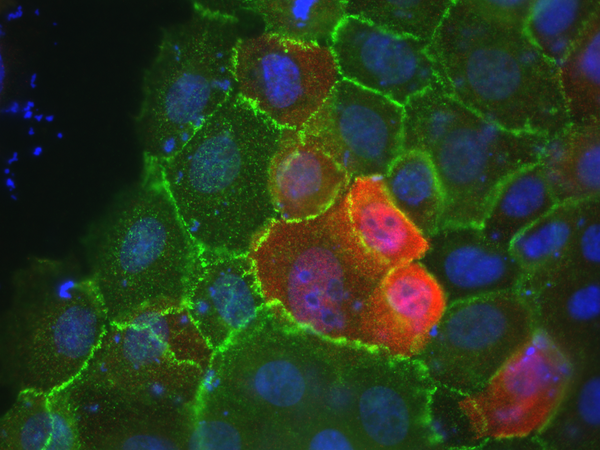

In [17]:
img = imread("data/1_resized.png")
showarray(img)

The RGB channels correspond to 3 different cell components

ACTIN,HECD1,DAPI
,,

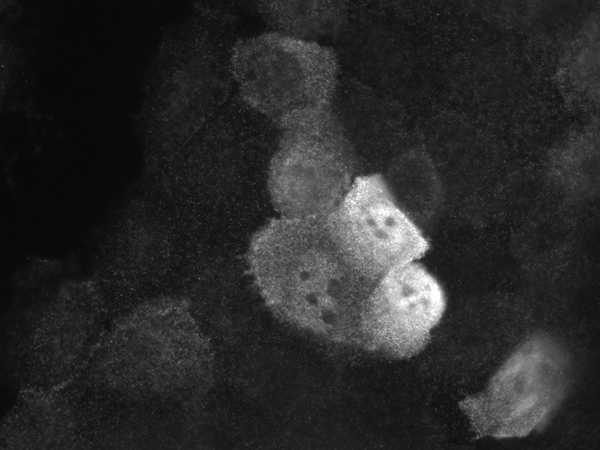
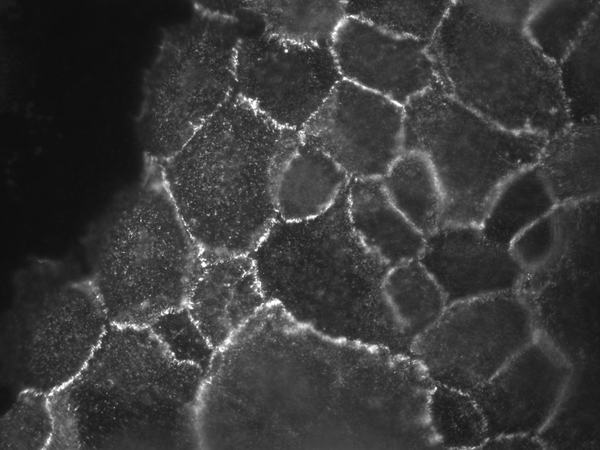
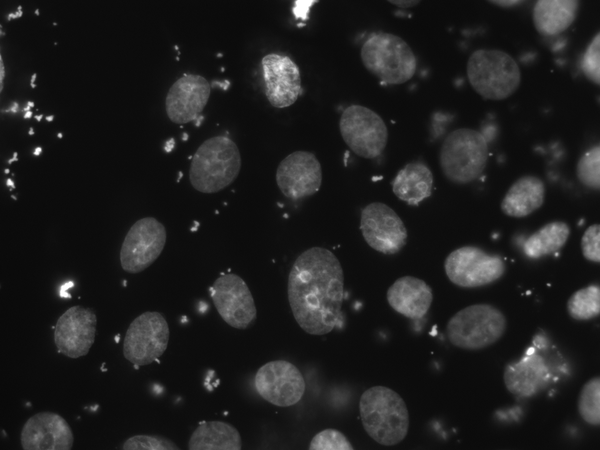

In [18]:
actin, hecd1, dapi = img[:,:,0], img[:,:,1], img[:,:,2]
showarrays([actin, hecd1, dapi],
           column_titles=["ACTIN", "HECD1", "DAPI"])

In [ ]:
plt.switch_backend('module://ipykernel.pylab.backend_inline')

cropped_hecd1 = nd.gaussian_filter(img[200:400,200:400,1],1.0)
cropped_dapi = dapi[200:400,200:400]

X, Y = np.mgrid[0:hecd1.shape[0],0:hecd1.shape[1]]

fig = plt.figure()
ax = fig.gca(projection='3d')
surf = ax.plot_surface(X, Y, hecd1, rstride=1, cstride=1, cmap=cm.jet,
                       linewidth=0, antialiased=False)
ax.view_init(45, 0)

plt.savefig("data/cropped_hecd1_3d.png", bbox_inches='tight', dpi=100)
imsave("data/cropped_hecd1.png", cropped_hecd1)
imsave("data/cropped_dapi.png", cropped_dapi)
plt.close(fig)
plt.switch_backend('nbAgg')

<b>Watershed segmentation:</b><br>
starting from seed points,<br>
regions grow as if water was flowing from the seeds<br>
and pixel intensities were the altitude

<br><br>

<div style="float: left;"><center><table style="width:100%; border:0px !important; border-collapse:collapse;"><tbody><tr style="border: 0px !important;"><td style="border:0px !important;"><center><b>Cropped HECD1</b></center></td><td style="border:0px !important;"><center><b>Cropped HECD1 (3D)</b></center></td><td style="border:0px !important;"><center><b>Cropped DAPI</b></center></td></tr>
<tr style="border: 0px !important;"><td style="border: 0px !important;"><img width="200" src="data/cropped_hecd1.png"></td><td style="border: 0px !important;"><img width="484" src="data/cropped_hecd1_3d.png"></td><td style="border: 0px !important;"><img width="200" src="data/cropped_dapi.png"></td></tr>
</tbody></table></center></div>

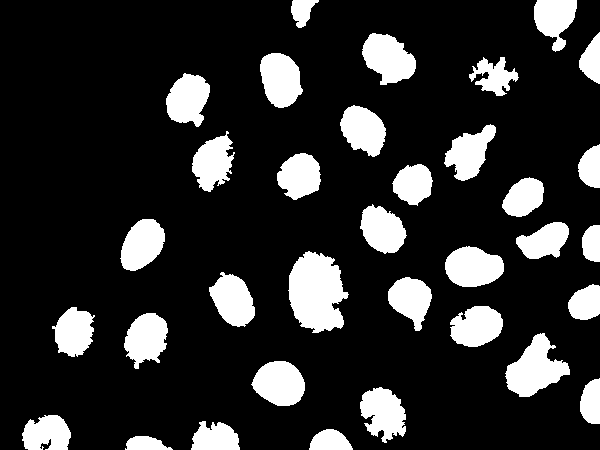

In [19]:
import scipy.ndimage as nd
from skimage.morphology import remove_small_objects

res = {}
def callback_function(threshold, small):
    res['img'] = dapi>threshold
    res['img'] = remove_small_objects(res['img'], min_size=small)
    res['img'] = nd.binary_fill_holes(res['img'])
    showarray(res['img']*255)

slider = interact(callback_function, threshold=(0,255),
                  small=(0,500),
                 continuous_update=False);

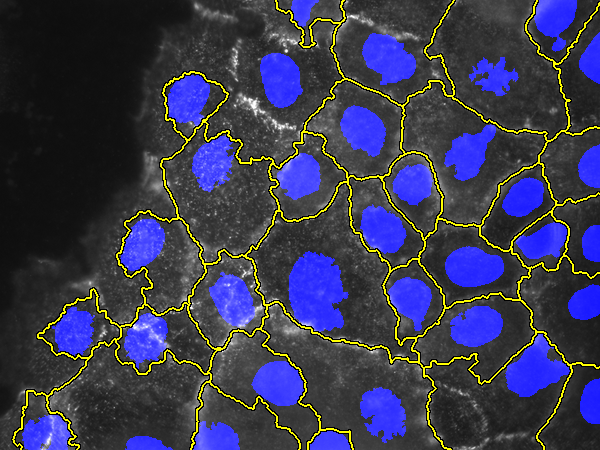

In [20]:
from skimage.morphology import watershed
from skimage.segmentation import mark_boundaries

seeds,nb_labels = nd.label(res['img'])
seg = watershed(nd.gaussian_filter(hecd1,1.0), seeds)

tmp_img = np.concatenate((hecd1[...,np.newaxis],)*3,axis=-1)
tmp_img[:,:,2][seeds>0] = 255
showarray(mark_boundaries(tmp_img,seg,color=(1, 1, 0),
                          outline_color=(0,0,0))*255)

Now, how do we segment the rest of the human body?

<center><img src="data/preprocessing.png" style="height:600px;"></center>

Now, how do we segment the rest of the human body?

<center><img src="data/segmentation.png"  style="height:600px;"/></center>

Or at least part of it?

<center><img src="data/atlas/01_op.png" style="height:500px;"/></center>

<br><br><br>

The key is to learn from data instead of pipelining lots of image processing steps

<br><br><br>

But first we need annotated data

<IPython.core.display.Javascript object>


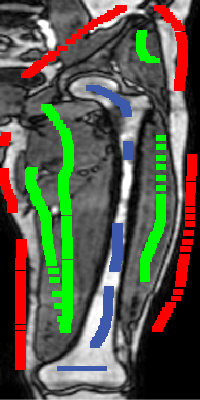

In [21]:
%matplotlib notebook

img = imread("data/atlas/02_op.png")

seg = np.ma.array(np.zeros(img.shape, dtype='uint8'),
                  mask=np.ones(img.shape))
MatplotlibDraw(img, seg, n_labels=3, figsize=(10,20), dpi=20)

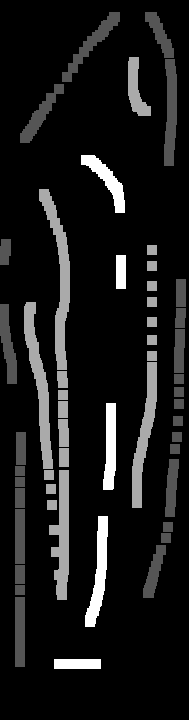

In [22]:
showarray(seg/seg.max()*255, width=200)

,

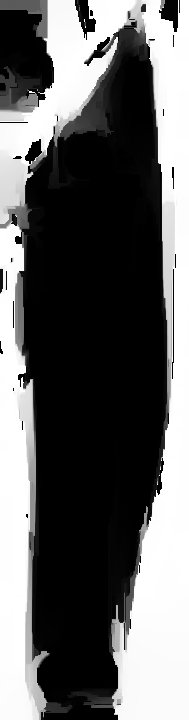
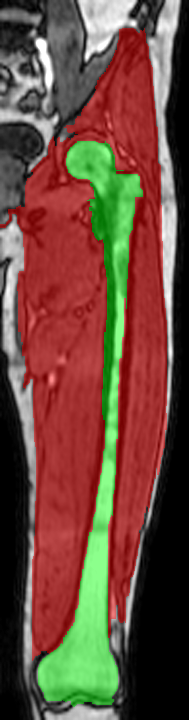

In [23]:
from skimage.segmentation import random_walker

def callback_function(beta):
    labels = random_walker(img, np.array(seg), beta=beta, mode='cg_mg', 
                       return_full_prob=True)
    final_seg = np.argmax(labels,axis=0)
    showarrays([labels[0,:,:]*255,
              overlay_segmentation(img,final_seg)], width=75)
    

slider = interact(callback_function, beta=(0,10000),
                 continuous_update=False); 

Instead of Random Walker:
 * graph cuts (see `pygco` https://github.com/amueller/gco_python)
 * grabcut (see `opencv`)
 * Random Forests (see paper <i>"GeoS: Geodesic Image Segmentation"</i> from Microsoft Research)
 
For serious manual segmentation:
 * ITK-Snap
 * MITK

So now we have annotated data.


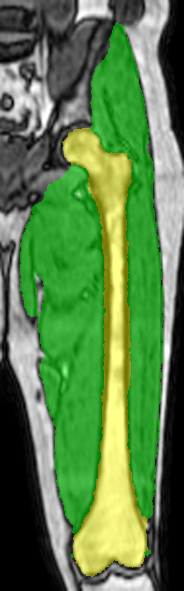
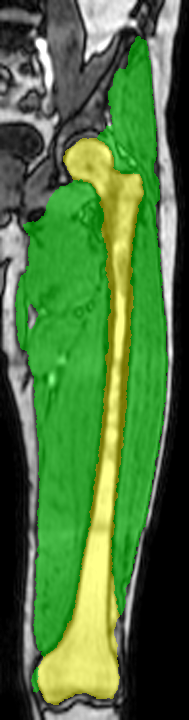
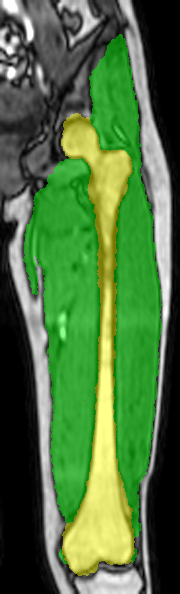
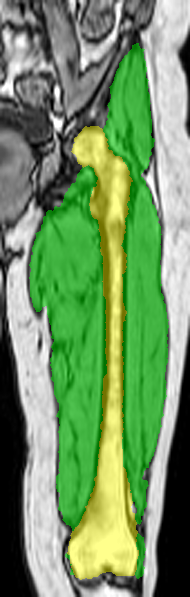
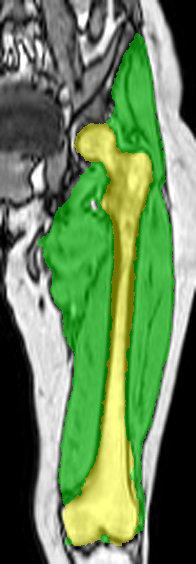
...
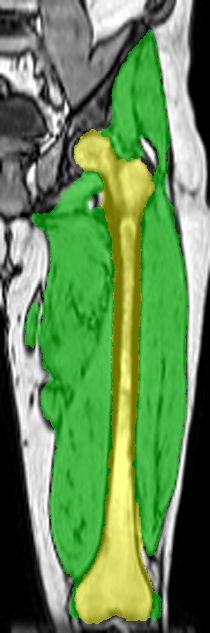
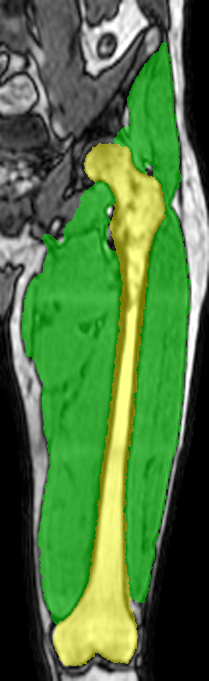
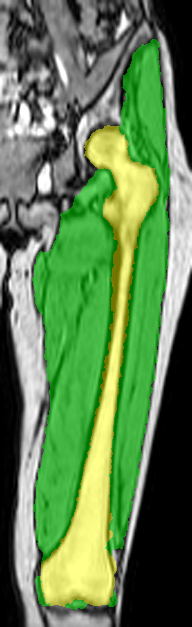
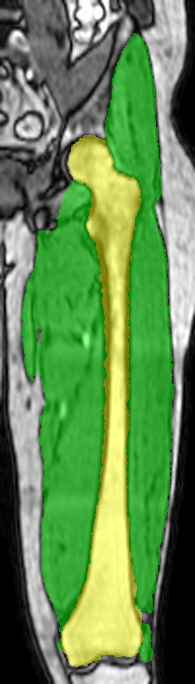
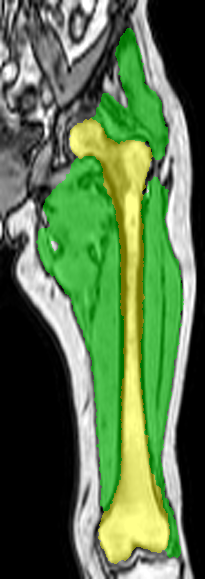

In [24]:
all_files = list(map(imread,glob("data/atlas/*_overlay.png")))
showarrays(all_files,n_columns=6, width=75)

<center><h2>Atlas segmentation</h2></center><br>

<center><img src="data/leg_warping.gif"  style="height:500px;"/></center>

In [25]:
import SimpleITK as sitk

def warp_segmentation(fixed, moving, seg):
    
    # from numpy to SimpleITK
    fixed = sitk.GetImageFromArray(fixed)
    moving = sitk.GetImageFromArray(moving)
    seg = sitk.GetImageFromArray(seg)
    
    # initialise bspline transform
    mesh_size = [4] * moving.GetDimension()
    tx = sitk.BSplineTransformInitializer(fixed, mesh_size, order=3)

    # set up registration framework
    registration_method = sitk.ImageRegistrationMethod()

    registration_method.SetMetricAsCorrelation()
    registration_method.SetOptimizerAsLBFGSB(gradientConvergenceTolerance=1e-5,
                                             numberOfIterations=100,
                                             maximumNumberOfCorrections=5,
                                             maximumNumberOfFunctionEvaluations=1000,
                                             costFunctionConvergenceFactor=1e+7)
    registration_method.SetGlobalWarningDisplay(False)

    registration_method.SetOptimizerScalesFromPhysicalShift()

    # Multi-resolution framework - it's this easy:
    registration_method.SmoothingSigmasAreSpecifiedInPhysicalUnitsOn()
    registration_method.SetShrinkFactorsPerLevel(shrinkFactors=[8,4])
    registration_method.SetSmoothingSigmasPerLevel(smoothingSigmas=[4,2])

    registration_method.SetInitialTransform(tx, True)
    registration_method.SetInterpolator(sitk.sitkLinear)

    # run the registration
    outTx = registration_method.Execute(sitk.Cast(fixed, sitk.sitkFloat32),
                                        sitk.Cast(moving, sitk.sitkFloat32))

    # warp segmentation
    resampler = sitk.ResampleImageFilter()
    resampler.SetReferenceImage(fixed)
    resampler.SetInterpolator(sitk.sitkNearestNeighbor)
    resampler.SetDefaultPixelValue(0)
    resampler.SetTransform(outTx)

    # return a numpy array
    return sitk.GetArrayFromImage(resampler.Execute(seg))

In [26]:
all_seg = list(map(imread,sorted(glob("data/atlas/*_seg.png"))))
all_img = list(map(imread,sorted(glob("data/atlas/*_op.png"))))

fixed_img = all_img[0]
proba = np.zeros((*fixed_img.shape,3), dtype='float')

display(HTML("<div id='registration_output'></div>"))

s = ""
for moving_img, moving_seg in zip(all_img[1:],all_seg[1:]):
    warped_moving_seg = warp_segmentation(fixed_img, 
                                          moving_img, moving_seg)
    for i in range(proba.shape[-1]):
        proba[:,:,i] += warped_moving_seg == i
    s += htmlarray(overlay_segmentation(fixed_img,warped_moving_seg))
    display(Javascript('registration_output.innerHTML = "'+s+'";'))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Thigh muscle,Femur,Final segmentation
,,

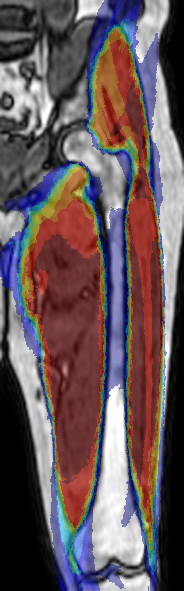
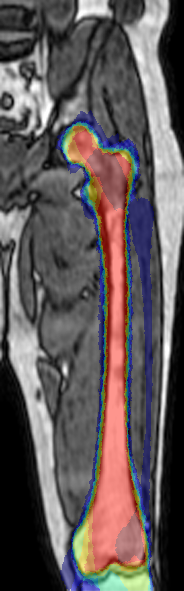
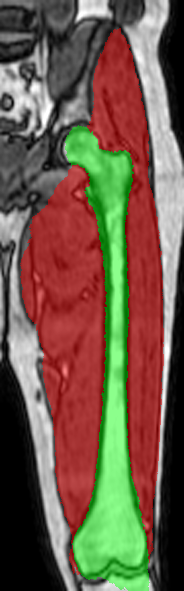

In [27]:
fig1, _ = plot_image(fixed_img, proba=proba[:,:,1], backend='agg')
fig2, _ = plot_image(fixed_img, proba=proba[:,:,2], backend='agg')
final_seg = overlay_segmentation(fixed_img, 
                                 np.argmax(proba,axis=-1))
showarrays([fig1,fig2,final_seg], 
           column_titles=["Thigh muscle", "Femur", "Final segmentation"])

Image registration is a must-have in your image analysis toolbox

<center><img src="data/visualising_body_changes.gif" style="height:600px;"></center>

In [ ]:
## fetus
# convert -density 600 notebooks/PyData_KevinKeraudren.pdf -colorspace sRGB -type TrueColorMatte -depth 8 tmp_slides/slide.png
# convert slide-38.png -crop 2200x1925+400+285  slide-38-cropped.png
# convert slide-54.png -crop 1480x1460+770+412  slide-54-cropped.png
# convert slide-43.png -crop 1760x890+164+778 +repage slide-43-cropped.png
# convert -delay 120 slide-{43..50}-cropped.png integral_image.gif

Atlas-based segmentation is great, but would it work for this?

<center><img src="data/slide-28.png" style="height:600px;"></center>

Atlas-based segmentation is great, but would it work for this?

<center><img src="data/slide-29.png" style="height:600px;"></center>

<b>Random Forest</b> and binary features obtained by comparing the mean intensity of pairs of 3D patches.

<center><img src="data/patch_features.gif" style="width:600px;"></center>

<center><b>Integral image for axis-aligned cube features</b></center><br>

\begin{equation*}
ii(x,y) = \sum\limits_{x' \leq x, y' \leq y} I(x',y')
\end{equation*}

<br>

```
i_img = np.cumsum(np.cumsum(img,1),0)
```

<br><br>

<center><img src="data/integral_image.gif" style="width:500px;"></center>

<div style='float: none;'><center>
<table style='width:100%; border:0px !important;'><tr style='border: 0px !important;'>
<td style="border:0px !important;line-height: 150%;">
Randomness:<br>

<ul>
  <li>randomly subsample training data for each tree</li>
  <li>randomly subsample possible features at every node</li>
</ul>

<br>

Features selected to minimise the mean squared error.

</td>
<td style="border:0px !important;">
<center><img src="data/forest.png" style="width:600px;"></center>
</td></tr>
</table>
</center></div>




Prediction obtained from averaging the output from lots of trees.

<center>
<img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;transform:scaleX(-1);"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;transform:scaleX(-1);"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;transform:scaleX(-1);"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;transform:scaleX(-1);"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;"> <img src="data/forest.png" style="height:200px;display: inline;vertical-align:baseline;transform:scaleX(-1);">
</center>

<center>
<b>Classification then regression: heart</b><br><br>

<img src="data/slide-54-cropped.png" style="width:500px;"></center>

<center>
<b>Classification then regression: heart</b><br><br>

<img src="data/slide-55-cropped.png" style="width:500px;"></center>

<center>
<b>Classification then regression: heart</b><br><br>

<img src="data/slide-56-cropped.png" style="width:500px;"></center>

<center>
<b>Classification then regression: lungs & liver</b><br><br>

<img src="data/slide-57-cropped.png" style="width:500px;"></center>

<center>
<b>Classification then regression: lungs & liver</b><br><br>

<img src="data/slide-58-cropped.png" style="width:500px;"></center>

```python
from sklearn.ensemble import RandomForestClassifier
```

<div style="float: left;"><center><table style="width:100%; border:0px !important; border-collapse:collapse;"><tbody><tr style="border: 0px !important;"><td style="border:0px !important;"><center><b>Axis aligned</b></center></td><td style="border:0px !important;"><center><b>Linear</b></center></td><td style="border:0px !important;"><center><b>Parabolas</b></center></td></tr>
<tr style="border: 0px !important;">
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_AxisAligned_soft.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_Linear_soft.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_Parabola_soft.png" style="height:300px;"></td></tr>
<tr style="border: 0px !important;">
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_AxisAligned_hard.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_Linear_hard.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/classification_forest_sklearn_Parabola_hard.png" style="height:300px;"></td></tr>
</tbody></table></center></div>

```python
from sklearn.ensemble import RandomForestRegressor
```

<div style="float: left;"><center><table style="width:100%; border:0px !important; border-collapse:collapse;"><tbody><tr style="border: 0px !important;"><td style="border:0px !important;"><center><b>Axis aligned</b></center></td><td style="border:0px !important;"><center><b>Linear</b></center></td><td style="border:0px !important;"><center><b>Parabolas</b></center></td></tr>
<tr style="border: 0px !important;">
<td style="border: 0px !important;"><img src="data/img_randomforest/regression_forest_sklearn_AxisAligned.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/regression_forest_sklearn_Linear.png" style="height:300px;"></td>
<td style="border: 0px !important;"><img src="data/img_randomforest/regression_forest_sklearn_Parabola.png" style="height:300px;"></td></tr>
</tbody></table></center></div>

<b>Combining classification and regression</b>

Can be done in Python:
* `numpy.ravel_multi_index`
* `numpy.bincount` using arguments `minlength` and `weights`
* `numpy.reshape`

Or in Cython:

```cython
from cython.parallel import prange

...

with nogil:
    for z in prange(shape0):
        for y in range(shape1):
            for x in range(shape2):
                ...
```

<br><br><br>

<center><h2>Visualisation</h2></center>

In [ ]:
# convert vertebrae_labels.png -crop 2077x950+0+200  vertebrae_labels_cropped.png

Whenever starting a new project, first step is to visualize the data:
 * plain numpy + save as PNG
 * matplotlib
 * VTK
 
<center><img src="data/vertebrae_labels_cropped.png" style="width:800px;"></center>

<div style='float: none;'><center>

vtkMarchingCubes &rarr; vtkSmoothPolyDataFilter &rarr; vtkCleanPolyData
&rarr; vtkPolyDataNormals<br>
<br>
vtkImageStencil &larr; vtkPolyDataToImageStencil

<table style='width:100%; border:0px !important;'><tr style='border: 0px !important;'>
<td style="border:0px !important;line-height: 150%;">
mc = vtk.vtkMarchingCubes()<br>
mc.ComputeScalarsOn()<br>
mc.ComputeGradientsOn()<br>
mc.ComputeNormalsOn()<br>
mc.SetValue(0, threshold)<br>
mc.SetInputData(vtk_image_data)<br>
mc.Update()<br>
<br>
polydata = mc.GetOutput()<br>
</td>
<td style="border:0px !important;">
<center><img src="data/body.gif" style="width:250px;"></center>
</td></tr>
</table>
</center></div>

```python
from vtk.util import numpy_support

...

np_array = numpy_support.vtk_to_numpy(vtk_array)

...

vtk_array = numpy_support.numpy_to_vtk(np_array, deep=True)
```
<br><br>
https://github.com/Kitware/VTK/blob/master/Wrapping/Python/vtk/util/numpy_support.py

In [28]:
# Adapted from http://docs.enthought.com/mayavi/mayavi/auto/example_mri.html

import SimpleITK as sitk
import numpy as np

from mayavi import mlab
mlab.init_notebook()

mlab.figure(bgcolor=(1, 1, 1), size=(800, 800))


sitk_img = sitk.ReadImage("data/stack-1.nii.gz")
img = sitk.GetArrayFromImage(sitk_img)

sitk_seg = sitk.ReadImage("data/fetus_segmentation.nii.gz")
seg = sitk.GetArrayFromImage(sitk_seg)

src_img = mlab.pipeline.scalar_field(img)
# non isotropic data
src_img.spacing = sitk_img.GetSpacing()[::-1]
src_img.update_image_data = True

cut_plane1 = mlab.pipeline.scalar_cut_plane(src_img,
                                plane_orientation='x_axes',
                                colormap='black-white',
                                vmin=0,
                                vmax=2500)
cut_plane1.implicit_plane.origin = (68, 140, 190)
cut_plane1.implicit_plane.widget.enabled = False

cut_plane2 = mlab.pipeline.scalar_cut_plane(src_img,
                                plane_orientation='y_axes',
                                colormap='black-white',
                                vmin=0,
                                vmax=2500)
cut_plane2.implicit_plane.origin = (68, 170, 190)
cut_plane2.implicit_plane.widget.enabled = False


colormap = np.array([[0, 0, 255],  # blue
                     [255, 0, 0],  # red
                     [0, 255, 0],  # green
                     [61, 89, 171],  # cobalt
                     [237, 145, 33],  # carrot
                    ], dtype='float')/255

for i in range(1,seg.max()+1):
    src_seg = mlab.pipeline.scalar_field((seg==i).astype('uint8'))
    src_seg.spacing = sitk_seg.GetSpacing()[::-1]
    src_seg.update_image_data = True
    outer = mlab.pipeline.iso_surface(mlab.pipeline.extract_grid(src_seg),
                                      contours=[1],
                                        color=tuple(colormap[i-1]),
                                     opacity=0.5)

outer

Notebook initialized with x3d backend.


More code on github:
* https://github.com/kevin-keraudren/cell-segmentation (in R)
* https://github.com/kevin-keraudren/fetus-detector
* https://github.com/kevin-keraudren/randomforest-python

But how can code (and trained models) survive time?

Use Anaconda to easily freeze package versions!

For instance <b>Anaconda 2.1.0</b>

https://docs.continuum.io/anaconda/old-pkg-lists/2.1.0/py27

<img src="data/anaconda_packages.png" style="width:600px;">

<center><h1>thanks!</h1></center>

Acknowledgements

* https://github.com/damianavila/RISE
* http://sherifsoliman.com/2016/01/11/theming-ipython-jupyter-notebook/

Jupyter notebook available at:<br>
https://github.com/kevin-keraudren/pydata-meetup-20161101

What I presented is based on my work at <i>Imperial College London</i> and <i>Klarismo</i>.